# Importa módulos necesarios y establece configuraciones

In [1]:
#                                                                            |
import pandas as pd
from time import time
import matplotlib.pyplot as plt
import pandas as pd
import funs
from IPython.display import display
import numpy as np
import seaborn as sns
import plotly.plotly as py
from plotly.graph_objs import *
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
pd.options.display.float_format = '{:.2f}'.format
pd.options.display.max_rows = 10

C:\Users\Jergb\Anaconda3\lib\site-packages\ggplot\utils.py:81: FutureWarning: pandas.tslib is deprecated and will be removed in a future version.
You can access Timestamp as pandas.Timestamp
  pd.tslib.Timestamp,


### Lee los nodos en un diccionario de dataframes

In [2]:
#                                                                            |
tablas={}
for nodo in [2,3,4,5,6,8]:
    tablas[nodo] = pd.read_csv('medidas_nodo%s.csv'%nodo,parse_dates=True,
                               index_col=0)

In [3]:
tablas[2].columns[[2,4]]

Index(['INTENSIDAD LUMÍNICA', 'TEMPERATURA'], dtype='object')

### Grafica los valores de las variables de cada nodo en gráficas interactivas

In [4]:
for nodo in [2,3,4,5,6,8]:
    data = ([{'x': tablas[nodo].index,'y': tablas[nodo][col],'name': col}
             for col in tablas[nodo].columns])
    layout = dict(title = 'NODO %s' %nodo,
                  yaxis = dict(title = '°C, %RH, %Pw, Nivel UV'),
                  xaxis = dict(title = 'FECHA')
                 )
    fig = dict(data=data, layout=layout)
    iplot(fig,layout)

### Aplica funs.separa_datos: obtine para cada nodo una lista de DF con los registros obtenidos entre periodos de medición con separación de más de t minutos

In [5]:
#                                                                            |
# Aplica la función separa_nodos, que calcula el tamaño de los dataframes 
# entre periodos. Los periodos de medición corresponden a una separación
# entre registros  mayor a t minutos. t = 60*24, los registros se realizan 
# cada minuto, de modo que t equivale a un día.
t = 60 * 24
nodo, periodos = {}, {}
for i in [2,3,4,5,6,8]:
    nodo[i], periodos[i] = funs.separa_datos(tablas[i],t)

### Presenta información acerca de los periodos de medición

In [6]:
for i in periodos:    
    display('Nodo %s'%i,periodos[i])

'Nodo 2'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-04-27 05:18:00,2018-04-27 09:39:00,44,218,16.79,83.21,0 days 04:21:00,5 days 13:49:00
1,2018-05-02 23:28:00,2018-05-03 07:05:00,449,9,98.03,1.97,0 days 07:37:00,6 days 02:33:00
2,2018-05-09 09:38:00,2018-05-10 14:37:00,1721,19,98.91,1.09,1 days 04:59:00,12 days 18:45:00
3,2018-05-23 09:22:00,2018-05-26 07:00:00,4134,45,98.92,1.08,2 days 21:38:00,10 days 03:11:00
4,2018-06-05 10:11:00,2018-06-09 15:23:00,5137,936,84.59,15.41,4 days 05:12:00,1 days 17:28:00
5,2018-06-11 08:51:00,2018-06-15 18:29:00,6276,63,99.01,0.99,4 days 09:38:00,7 days 09:53:00
6,2018-06-23 04:22:00,2018-06-23 05:55:00,93,1,98.94,1.06,0 days 01:33:00,0 days 00:00:00


'Nodo 3'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-04-27 05:17:00,2018-04-27 09:32:00,37,219,14.45,85.55,0 days 04:15:00,5 days 14:12:00
1,2018-05-02 23:44:00,2018-05-03 07:04:00,433,8,98.19,1.81,0 days 07:20:00,6 days 02:45:00
2,2018-05-09 09:49:00,2018-05-10 14:37:00,1707,22,98.73,1.27,1 days 04:48:00,12 days 19:22:00
3,2018-05-23 09:59:00,2018-05-28 22:31:00,7930,23,99.71,0.29,5 days 12:32:00,7 days 11:44:00
4,2018-06-05 10:15:00,2018-06-08 18:39:00,4676,149,96.91,3.09,3 days 08:24:00,2 days 14:17:00
5,2018-06-11 08:56:00,2018-06-14 03:45:00,3967,43,98.93,1.07,2 days 18:49:00,9 days 00:35:00
6,2018-06-23 04:20:00,2018-06-23 05:48:00,89,0,100.00,0.00,0 days 01:28:00,0 days 00:00:00


'Nodo 4'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-04-27 05:17:00,2018-04-27 09:42:00,35,231,13.16,86.84,04:25:00,5 days 13:50:00
1,2018-05-02 23:32:00,2018-05-03 03:24:00,218,15,93.56,6.44,03:52:00,6 days 07:12:00
2,2018-05-09 10:36:00,2018-05-09 14:05:00,185,25,88.10,11.90,03:29:00,13 days 20:17:00
3,2018-05-23 10:22:00,2018-05-24 10:16:00,203,1232,14.15,85.85,23:54:00,0 days 00:00:00


'Nodo 5'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-04-27 05:17:00,2018-04-27 05:17:00,1,0,100.00,0.00,0 days 00:00:00,5 days 18:29:00
1,2018-05-02 23:46:00,2018-05-03 07:04:00,436,3,99.32,0.68,0 days 07:18:00,6 days 03:21:00
2,2018-05-09 10:25:00,2018-05-10 14:36:00,1673,19,98.88,1.12,1 days 04:11:00,12 days 19:32:00
3,2018-05-23 10:08:00,2018-05-26 08:33:00,4202,24,99.43,0.57,2 days 22:25:00,10 days 01:48:00
4,2018-06-05 10:21:00,2018-06-15 04:40:00,11315,2745,80.48,19.52,9 days 18:19:00,7 days 23:45:00
5,2018-06-23 04:25:00,2018-06-23 05:55:00,89,2,97.80,2.20,0 days 01:30:00,0 days 00:00:00


'Nodo 6'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-04-27 05:18:00,2018-04-27 05:46:00,8,21,27.59,72.41,0 days 00:28:00,5 days 17:39:00
1,2018-05-02 23:25:00,2018-05-03 07:05:00,433,28,93.93,6.07,0 days 07:40:00,6 days 02:31:00
2,2018-05-09 09:36:00,2018-05-10 14:37:00,1620,122,93.00,7.00,1 days 05:01:00,12 days 19:06:00
3,2018-05-23 09:43:00,2018-05-23 10:37:00,47,8,85.45,14.55,0 days 00:54:00,0 days 00:00:00


'Nodo 8'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
0,2018-05-02 23:54:00,2018-05-03 00:06:00,2,11,15.38,84.62,0 days 00:12:00,21 days 09:35:00
1,2018-05-24 09:41:00,2018-05-29 07:12:00,6438,614,91.29,8.71,4 days 21:31:00,7 days 03:25:00
2,2018-06-05 10:37:00,2018-06-09 15:47:00,1921,4150,31.64,68.36,4 days 05:10:00,1 days 01:46:00
3,2018-06-10 17:33:00,2018-06-11 09:55:00,115,868,11.70,88.30,0 days 16:22:00,3 days 23:17:00
4,2018-06-15 09:12:00,2018-06-15 11:45:00,152,2,98.70,1.30,0 days 02:33:00,7 days 16:51:00
5,2018-06-23 04:36:00,2018-06-23 05:48:00,42,31,57.53,42.47,0 days 01:12:00,0 days 00:00:00


### Aplica un filtro a los registros, cualquier periodo de medición con menos de mr registros es eliminado

In [7]:
# mr es la cantidad mínima de registros
mr = 1e3
for i in periodos:
    borrar =[]
    for j in periodos[i].index:
        if periodos[i].iloc[j,2] < mr:
            borrar.append(j)
            nodo[i][j]=np.nan
    periodos[i] = periodos[i].drop(index=borrar)
    nodo[i] = [nodo[i][x] for x in periodos[i].index if not(x in borrar)]

### Presenta la información relacionada a los periodos de medición para cada nodo luego de aplicado el filtro de cantidad de registros

In [8]:
for i in periodos:
    display('Nodo %s'%i,periodos[i])

'Nodo 2'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
2,2018-05-09 09:38:00,2018-05-10 14:37:00,1721,19,98.91,1.09,1 days 04:59:00,12 days 18:45:00
3,2018-05-23 09:22:00,2018-05-26 07:00:00,4134,45,98.92,1.08,2 days 21:38:00,10 days 03:11:00
4,2018-06-05 10:11:00,2018-06-09 15:23:00,5137,936,84.59,15.41,4 days 05:12:00,1 days 17:28:00
5,2018-06-11 08:51:00,2018-06-15 18:29:00,6276,63,99.01,0.99,4 days 09:38:00,7 days 09:53:00


'Nodo 3'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
2,2018-05-09 09:49:00,2018-05-10 14:37:00,1707,22,98.73,1.27,1 days 04:48:00,12 days 19:22:00
3,2018-05-23 09:59:00,2018-05-28 22:31:00,7930,23,99.71,0.29,5 days 12:32:00,7 days 11:44:00
4,2018-06-05 10:15:00,2018-06-08 18:39:00,4676,149,96.91,3.09,3 days 08:24:00,2 days 14:17:00
5,2018-06-11 08:56:00,2018-06-14 03:45:00,3967,43,98.93,1.07,2 days 18:49:00,9 days 00:35:00


'Nodo 4'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro


'Nodo 5'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
2,2018-05-09 10:25:00,2018-05-10 14:36:00,1673,19,98.88,1.12,1 days 04:11:00,12 days 19:32:00
3,2018-05-23 10:08:00,2018-05-26 08:33:00,4202,24,99.43,0.57,2 days 22:25:00,10 days 01:48:00
4,2018-06-05 10:21:00,2018-06-15 04:40:00,11315,2745,80.48,19.52,9 days 18:19:00,7 days 23:45:00


'Nodo 6'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
2,2018-05-09 09:36:00,2018-05-10 14:37:00,1620,122,93.00,7.00,1 days 05:01:00,12 days 19:06:00


'Nodo 8'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración,Tiempo Hasta el Siguiente Registro
1,2018-05-24 09:41:00,2018-05-29 07:12:00,6438,614,91.29,8.71,4 days 21:31:00,7 days 03:25:00
2,2018-06-05 10:37:00,2018-06-09 15:47:00,1921,4150,31.64,68.36,4 days 05:10:00,1 days 01:46:00


#### Se evidencian tres periodos de medición para los cuales hay registros de los nodos 2, 3, 5, 6 y 8

### Se agregan los indíces de los registros faltantes y se asignan valores NaN a las variables

In [9]:
for i in nodo:
    for j in range(len(nodo[i])):
        nodo[i][j] = nodo[i][j].asfreq('60S')

#### A continuación se presentan las gráficas de las variables durante tres periodos de medición. 
### Gráficas para el primer periodo

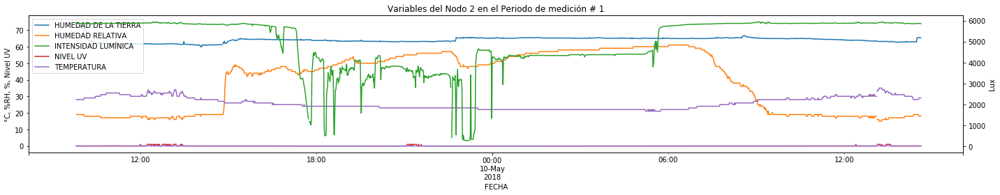

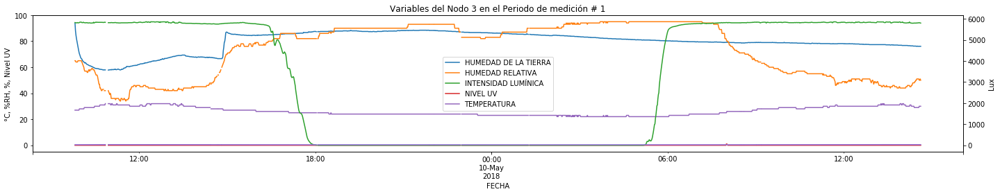

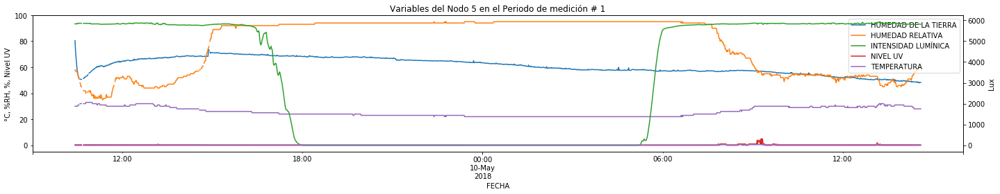

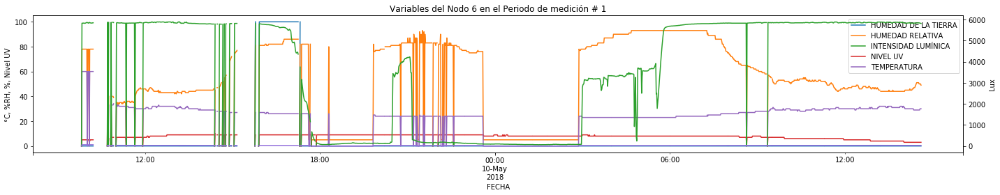

In [10]:
#                                                                            |
T = 0
for i in [2,3,5,6]:
    ax=nodo[i][T].iloc[:,0:5].plot(figsize=[20,4],
                                  secondary_y='INTENSIDAD LUMÍNICA'
                                  ,mark_right=None)
    ax2=nodo[i][T].iloc[:,4].plot(secondary_y=True,color='mediumpurple')
    ax.set_ylabel('°C, %RH, %, Nivel UV')
    ax2.set_ylabel('Lux')
    ax.set_xlabel('FECHA')
    ax.set_title('Variables del Nodo %d en el Periodo de medición # %d'%\
                 (i,T+1))
    plt.tight_layout()
    plt.show()

#### Para el primer periodo los registros de los nodos 2, 3 y 5 presentan gran similitud, tanto para los valores medidos de cada variable como para el rango de fechas de los registros, se eceptúa el caso del sensor de PT550 del nodo 2, pues los valores de la variable intensidad luminica registrados en la noche están errados, sea por falla en el sensor o por alguna fuente de luz presente en su cercanía.
#### Fallas en los valores registrados por el nodo 6
- Se observan periodos de hasta tres horas sin registrar datos de las variables Humedad Relativa y Temperatura, correspondientes al sensor DHT11.
- Los valores de la variable Nivel UV permanencen constantes durante todo el periodo de medición, registrando una media de 7.52, lo que indica que este sensor se encontraba defectuoso.
- La media de los valores de Humedad de la tierra registrados es de 5.14, lo que indica que este sensor podría estar defectuoso o desconectado.
### Gráficas para el segundo periodo

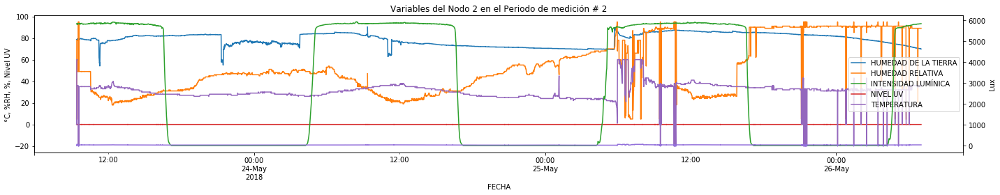

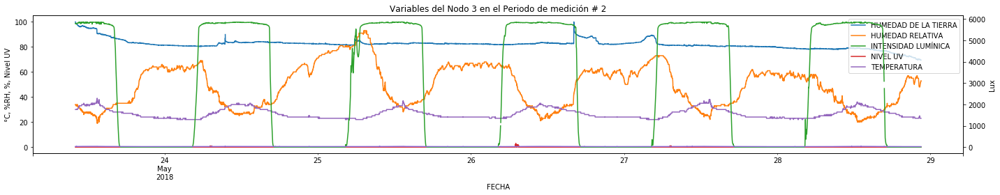

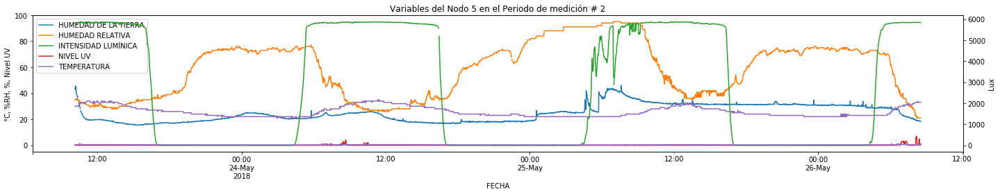

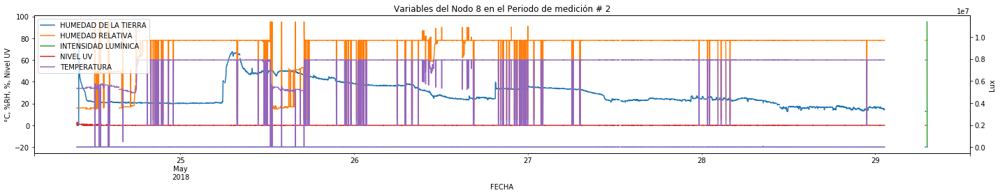

In [11]:
#                                                                            |
T = 1
for i in [2,3,5]:
    ax=nodo[i][T].iloc[:,0:5].plot(figsize=[20,4],
                                  secondary_y='INTENSIDAD LUMÍNICA'
                                  ,mark_right=None)
    ax2=nodo[i][T].iloc[:,4].plot(secondary_y=True,color='mediumpurple')
    ax.set_ylabel('°C, %RH, %, Nivel UV')
    ax2.set_ylabel('Lux')
    ax.set_xlabel('FECHA')
    ax.set_title('Variables del Nodo %d en el Periodo de medición # %d'%\
                 (i,T+1))
    plt.tight_layout()
    
ax=nodo[8][0].iloc[:,0:5].plot(figsize=[20,4],
                               secondary_y='INTENSIDAD LUMÍNICA'
                               ,mark_right=None)
ax2=nodo[8][0].iloc[:,4].plot(secondary_y=True,color='mediumpurple')
ax.set_ylabel('°C, %RH, %, Nivel UV')
ax2.set_ylabel('Lux')
ax.set_xlabel('FECHA')
ax.set_title('Variables del Nodo 8 en el Periodo de medición # 2')
plt.tight_layout()
plt.show()

#### Durante el segundo periodo de medición se presentaron fallas simultaneas en el sensor DTH11 del nodo 2 y variaciones anormales  en los registros de intensidad lumínica de los nodos 2, 3 y 5 crrespondientes a la mañana del 25 de mayo.
- Las diferencias respecto a los valores medidos en los nodos 2, 3 y 5 aunmentan en comparación a lo observado en el periodo de medición # 1.
#### El nodo 8 presentó fallas en todos sus sensores, salvo el orrespondiente a Humedad de la Tierra.

### Gráficas para el tercer periodo

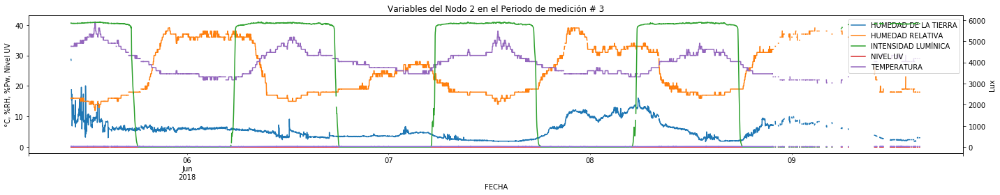

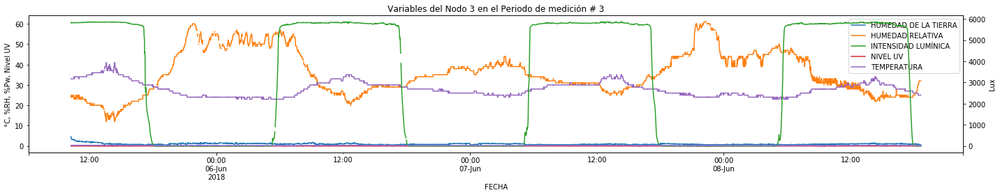

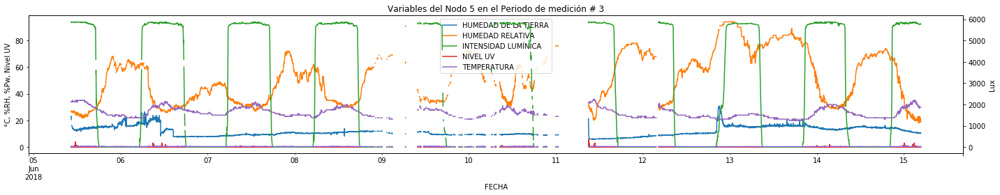

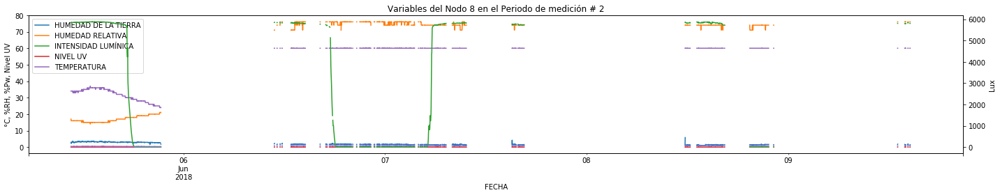

In [12]:
T = 2
for i in [2,3,5]:
    ax=nodo[i][T].iloc[:,0:5].plot(figsize=[20,4],
                                  secondary_y='INTENSIDAD LUMÍNICA'
                                  ,mark_right=None)
    ax2=nodo[i][T].iloc[:,4].plot(secondary_y=True,color='mediumpurple')
    ax.set_ylabel('°C, %RH, %Pw, Nivel UV')
    ax2.set_ylabel('Lux')
    ax.set_xlabel('FECHA')
    ax.set_title('Variables del Nodo %d en el Periodo de medición # %d'%\
                 (i,T+1))
    plt.tight_layout()
    
ax=nodo[8][1].iloc[:,0:5].plot(figsize=[20,4],
                               secondary_y='INTENSIDAD LUMÍNICA'
                               ,mark_right=None)
ax2=nodo[8][1].iloc[:,4].plot(secondary_y=True,color='mediumpurple')
ax.set_ylabel('°C, %RH, %Pw, Nivel UV')
ax2.set_ylabel('Lux')
ax.set_xlabel('FECHA')
ax.set_title('Variables del Nodo 8 en el Periodo de medición # 2')
plt.tight_layout()
plt.show()

#### Durante el tercer periodo de medición se presentaron las mayores similitudes entre las variables registradas en los nodos 2, 3 y 5.
- Los bajos niveles de humedad del suelo en todos los nodos corresponden a que han transcurrido varios días desde que se regó el cultivo por última vez y al redución de las precipitaciones en la región.

#### El nodo 8 no funcióno correctamente, los únicos registros correctos corresponden a las primeras 12 horas de medición.

##### A partir de la información anterior se establece que los nodos 6 y 8 no aportan información útil para el análisis de los datos, pues se evidencian demasiadas fallas en los valores. Además, se puede establecer que hay tres periodos de medición para los cuales se tienen registros simultaneos de los nodos 2, 3 y 5. 
- La variable Nivel UV no se va a considerar para el estudio, dado que la cantidad de valores medidos que corresponden a la incidencia de radiación solar directamente sobre los sensores se presentan en un reducido espacio de tiempo durante los días de medición, esto corresponde a la ubicación de los sensores a la altura de los frutos de cacao.

#### A continuación se procede a igualar los registros para los tres nodos teniendo en cuenta los siguientes rangos:
- Periodo 1: 2018-05-09 10:25:00 - 2018-05-10 14:36:00
- Periodo 2: 2018-05-23 10:08:00 - 2018-05-26 07:00:00
- Periodo 3: 2018-06-05 10:21:00 - 2018-06-08 18:40:00

### Se definen las fechas en las que inician y terminan los periodos de medición

In [13]:
inicio = {0: '2018-05-09 10:25:00',
          1: '2018-05-23 10:08:00',
          2: '2018-06-05 14:41:00'}
fin = {0: '2018-05-10 14:36:00',
       1: '2018-05-26 07:00:00',
       2: '2018-06-08 18:39:00'}

### Se extraen los rangos definidos para cada periodo de medición

In [14]:
#                                                                            |
node = {2:[], 3:[], 5:[]}
info = {2:[], 3:[], 5:[]}
for i in [2,3,5]:
    node[i]={}
    info[i]=pd.DataFrame(columns=['Registro Inicial', 'Registro Final',
                                  'Registrado', 'No Registrado',
                                  'Registrado(%)', 'No Registrado(%)',
                                  'Duración'])
    for T in range(3):
        node[i][T], infon = funs.info_periodo(nodo[i][T],inicio[T],fin[T])
        node[i][T] = node[i][T].drop(columns=['NIVEL UV'])
        info[i] = pd.concat([info[i],infon])
    info[i] = info[i].reset_index(drop=True)

In [15]:
node[2]

{0:                      HUMEDAD DE LA TIERRA  HUMEDAD RELATIVA  \
 2018-05-09 10:25:00                 62.61             18.00   
 2018-05-09 10:26:00                 62.61             18.00   
 2018-05-09 10:27:00                 62.45             18.00   
 2018-05-09 10:28:00                 62.45             18.00   
 2018-05-09 10:29:00                 62.45             18.00   
 ...                                   ...               ...   
 2018-05-10 14:32:00                 65.34             19.00   
 2018-05-10 14:33:00                 65.50             18.00   
 2018-05-10 14:34:00                 65.34             18.00   
 2018-05-10 14:35:00                 65.34             18.00   
 2018-05-10 14:36:00                 65.34             18.00   
 
                      INTENSIDAD LUMÍNICA  TEMPERATURA  
 2018-05-09 10:25:00              5853.00        29.00  
 2018-05-09 10:26:00              5853.00        29.00  
 2018-05-09 10:27:00              5853.00        29.00  

In [16]:
for i in [2,3,5]:
    display('Nodo %d'%i,info[i])
    

'Nodo 2'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración
0,2018-05-09 10:25:00,2018-05-10 14:36:00,1683,9,99.47,0.53,1 days 04:11:00
1,2018-05-23 10:08:00,2018-05-26 07:00:00,4092,41,99.01,0.99,2 days 20:52:00
2,2018-06-05 14:41:00,2018-06-08 18:39:00,4386,173,96.21,3.79,3 days 03:58:00


'Nodo 3'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración
0,2018-05-09 10:25:00,2018-05-10 14:36:00,1670,22,98.70,1.30,1 days 04:11:00
1,2018-05-23 10:08:00,2018-05-26 07:00:00,4121,12,99.71,0.29,2 days 20:52:00
2,2018-06-05 14:41:00,2018-06-08 18:39:00,4420,139,96.95,3.05,3 days 03:58:00


'Nodo 5'

,Registro Inicial,Registro Final,Registrado,No Registrado,Registrado(%),No Registrado(%),Duración
0,2018-05-09 10:25:00,2018-05-10 14:36:00,1673,19,98.88,1.12,1 days 04:11:00
1,2018-05-23 10:08:00,2018-05-26 07:00:00,4109,24,99.42,0.58,2 days 20:52:00
2,2018-06-05 14:41:00,2018-06-08 18:39:00,4368,191,95.81,4.19,3 days 03:58:00


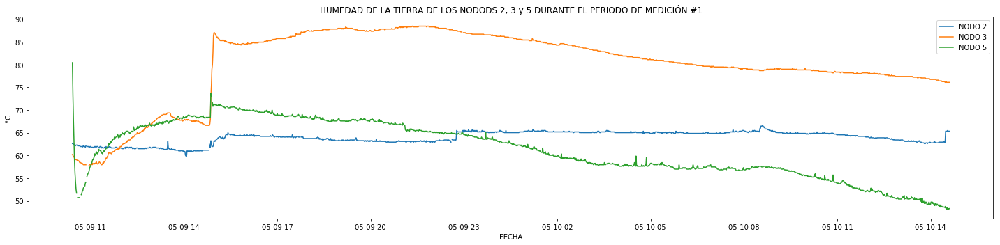

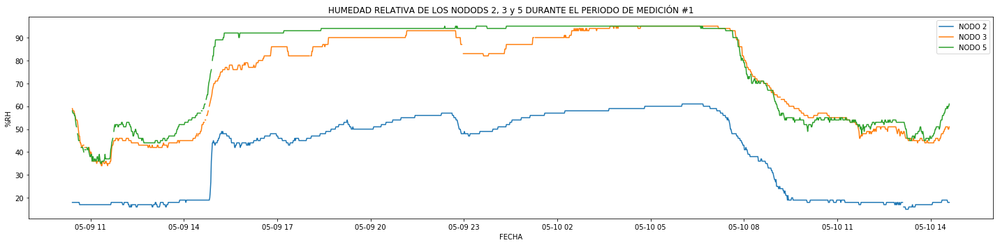

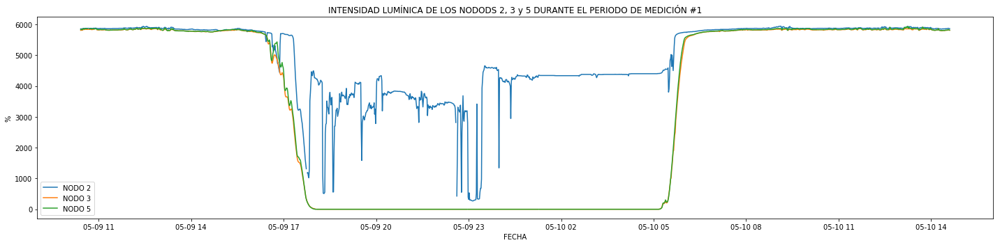

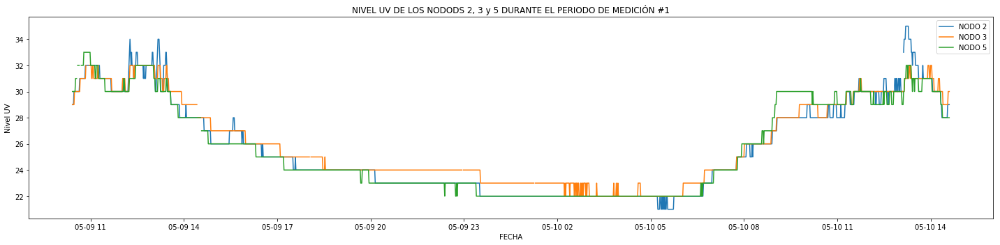

In [17]:
#                                                                            |
# Presenta los registros del primer periodo de medición de los nodos 2, 3 y 5 
T = 0
mag = {0:'°C', 1:'%RH', 2:'%', 3:'Nivel UV', 4:'lx'}
for i in range(4):
    plt.figure(figsize=[20,5])
    plt.title('%s DE LOS NODODS 2, 3 y 5 DURANTE EL PERIODO DE MEDICIÓN #%d'\
              %(nodo[2][0].columns[i],T+1))
    plt.xlabel('FECHA')
    plt.ylabel(mag[i])
    plt.plot(node[2][0].iloc[:,i],label='NODO 2')
    plt.plot(node[3][0].iloc[:,i],label='NODO 3')
    plt.plot(node[5][0].iloc[:,i],label='NODO 5')
    plt.legend()
    plt.tight_layout()
    plt.show()

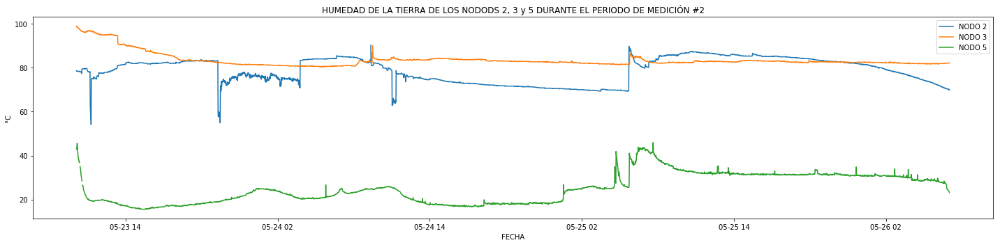

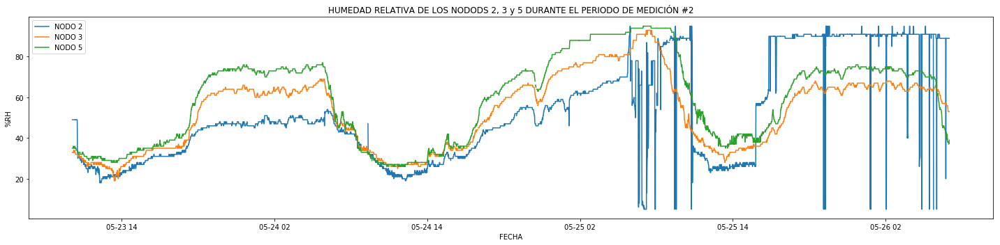

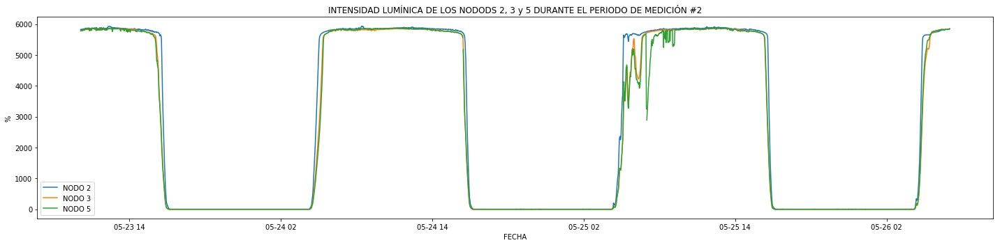

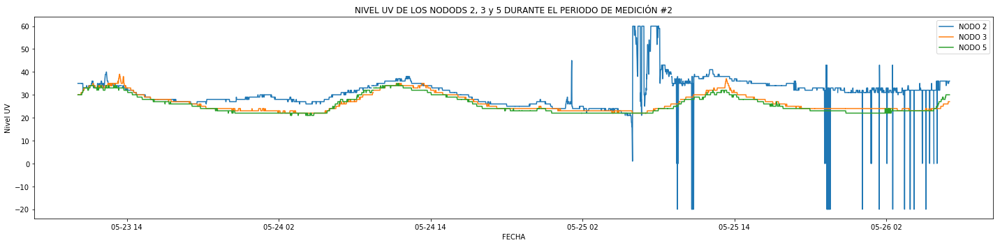

In [18]:
# Presenta los registros del segundo periodo de medición de los nodos 2, 3 y 5 
T = 1
mag = {0:'°C', 1:'%RH', 2:'%', 3:'Nivel UV', 4:'lx'}
for i in range(4):
    plt.figure(figsize=[20,5])
    plt.title('%s DE LOS NODODS 2, 3 y 5 DURANTE EL PERIODO DE MEDICIÓN #%d'\
              %(nodo[2][0].columns[i],T+1))
    plt.xlabel('FECHA')
    plt.ylabel(mag[i])
    plt.plot(node[2][T].iloc[:,i],label='NODO 2')
    plt.plot(node[3][T].iloc[:,i],label='NODO 3')
    plt.plot(node[5][T].iloc[:,i],label='NODO 5')
    plt.legend()
    plt.tight_layout()
    plt.show()

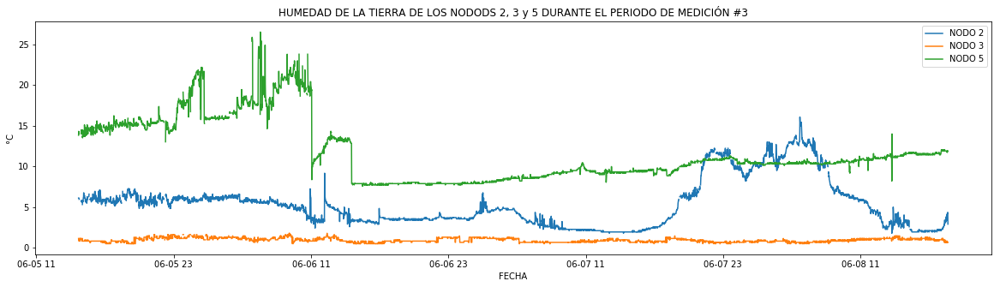

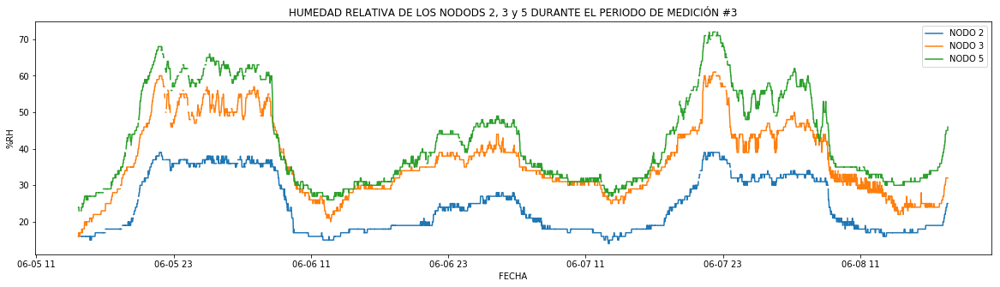

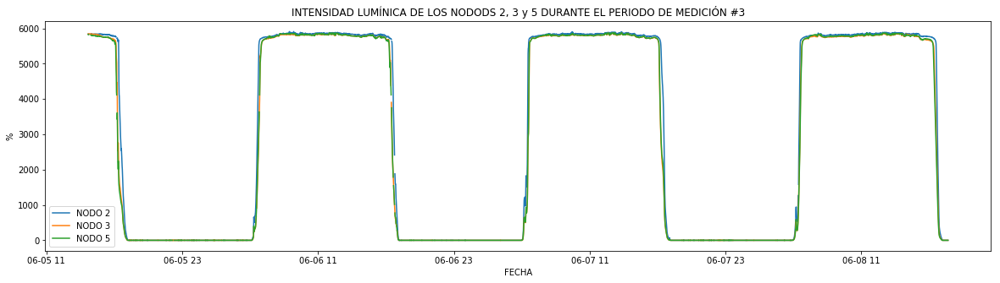

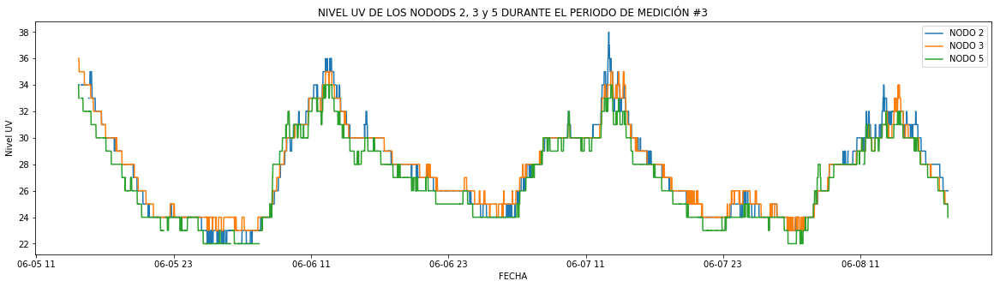

In [19]:
# Presenta los registros del tercer periodo de los nodos 2, 3 y 5 
T = 2
mag = {0:'°C', 1:'%RH', 2:'%', 3:'Nivel UV', 4:'lx'}
for i in range(4):
    plt.figure(figsize=[20,5])
    plt.title('%s DE LOS NODODS 2, 3 y 5 DURANTE EL PERIODO DE MEDICIÓN #%d'\
              %(nodo[2][0].columns[i],T+1))
    plt.xlabel('FECHA')
    plt.ylabel(mag[i])
    plt.plot(node[2][T].iloc[:,i],label='NODO 2')
    plt.plot(node[3][T].iloc[:,i],label='NODO 3')
    plt.plot(node[5][T].iloc[:,i],label='NODO 5')
    plt.legend()

### Se reemplazan los valores NaN con los valores registrados en filas superiores

In [20]:
for i in node:
    for T in range(3):
        for c in node[i][T].columns:
            display('nodo %d, Periodo %d, %s'%(i,j,c),node[i][j].info())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4092 non-null float64
HUMEDAD RELATIVA        4092 non-null float64
INTENSIDAD LUMÍNICA     4092 non-null float64
TEMPERATURA             4092 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 2, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4121 non-null float64
HUMEDAD RELATIVA        4121 non-null float64
INTENSIDAD LUMÍNICA     4121 non-null float64
TEMPERATURA             4121 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 3, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, TEMPERATURA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, HUMEDAD RELATIVA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

None

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4133 entries, 2018-05-23 10:08:00 to 2018-05-26 07:00:00
Freq: 60S
Data columns (total 4 columns):
HUMEDAD DE LA TIERRA    4109 non-null float64
HUMEDAD RELATIVA        4109 non-null float64
INTENSIDAD LUMÍNICA     4109 non-null float64
TEMPERATURA             4109 non-null float64
dtypes: float64(4)
memory usage: 161.4 KB


'nodo 5, Periodo 1, TEMPERATURA'

None

In [21]:
#                                                                            |
for i in node:
    for T in range(3):
        for c in node[i][T].columns:
            display('nodo %d, Periodo %d, %s'%(i,j,c),node[i][j][c].unique())

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18,   nan, 78.02, 77.38, 78.82, 79.3 , 79.46,
       79.62, 77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81,
       75.13, 74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89,
       77.7 , 77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07,
       81.23, 81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71,
       82.67, 82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63,
       60.04, 58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19,
       71.92, 69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68,
       74.49, 74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29,
       74.65, 76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08,
       70.79, 70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57,
       64.37, 63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21,
       65.18, 63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15,
       69.99, 69.51,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., nan, 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41.,
       42., 43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55.,
       56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68.,
       69., 70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,
        9., 74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03,       nan,
       5.865e+03, 5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03,
       5.888e+03, 5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03,
       5.806e+03, 5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03,
       5.782e+03, 5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03,
       5.747e+03, 5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03,
       5.712e+03, 5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03,
       5.648e+03, 5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03,
       4.715e+03, 4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03,
       2.961e+03, 2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03,
       1.607e+03, 1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02,
       5.980e+02, 4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02,
       1.700e+02, 1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01,
       4.100e+01, 3.500e+01, 2.300e+01, 1.700e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  nan,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,
        30.,  29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,
        20.,  18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,
        52.,  48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18,   nan, 78.02, 77.38, 78.82, 79.3 , 79.46,
       79.62, 77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81,
       75.13, 74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89,
       77.7 , 77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07,
       81.23, 81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71,
       82.67, 82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63,
       60.04, 58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19,
       71.92, 69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68,
       74.49, 74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29,
       74.65, 76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08,
       70.79, 70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57,
       64.37, 63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21,
       65.18, 63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15,
       69.99, 69.51,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., nan, 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41.,
       42., 43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55.,
       56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68.,
       69., 70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,
        9., 74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03,       nan,
       5.865e+03, 5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03,
       5.888e+03, 5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03,
       5.806e+03, 5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03,
       5.782e+03, 5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03,
       5.747e+03, 5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03,
       5.712e+03, 5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03,
       5.648e+03, 5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03,
       4.715e+03, 4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03,
       2.961e+03, 2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03,
       1.607e+03, 1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02,
       5.980e+02, 4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02,
       1.700e+02, 1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01,
       4.100e+01, 3.500e+01, 2.300e+01, 1.700e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  nan,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,
        30.,  29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,
        20.,  18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,
        52.,  48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18,   nan, 78.02, 77.38, 78.82, 79.3 , 79.46,
       79.62, 77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81,
       75.13, 74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89,
       77.7 , 77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07,
       81.23, 81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71,
       82.67, 82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63,
       60.04, 58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19,
       71.92, 69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68,
       74.49, 74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29,
       74.65, 76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08,
       70.79, 70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57,
       64.37, 63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21,
       65.18, 63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15,
       69.99, 69.51,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., nan, 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41.,
       42., 43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55.,
       56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68.,
       69., 70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,
        9., 74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03,       nan,
       5.865e+03, 5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03,
       5.888e+03, 5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03,
       5.806e+03, 5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03,
       5.782e+03, 5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03,
       5.747e+03, 5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03,
       5.712e+03, 5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03,
       5.648e+03, 5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03,
       4.715e+03, 4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03,
       2.961e+03, 2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03,
       1.607e+03, 1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02,
       5.980e+02, 4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02,
       1.700e+02, 1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01,
       4.100e+01, 3.500e+01, 2.300e+01, 1.700e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  nan,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,
        30.,  29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,
        20.,  18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,
        52.,  48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56,   nan, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44,
       97.28, 97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99,
       95.83, 95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55,
       94.39, 93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89,
       89.73, 89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45,
       87.65, 87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52,
       86.36, 86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63,
       83.47, 83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19,
       82.03, 81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75,
       80.59, 80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., nan, 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23.,
       21., 19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45.,
       46., 47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58.,
       59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42.,
       70., 71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82.,
       84., 86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03,       nan, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03,
       5.812e+03, 5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03,
       5.853e+03, 5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03,
       5.771e+03, 5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03,
       5.724e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03,
       5.642e+03, 5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03,
       5.478e+03, 5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03,
       4.991e+03, 4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03,
       4.217e+03, 4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03,
       3.325e+03, 3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03,
       2.539e+03, 2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03,
       1.595e+03, 1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03,
       9.090e+02, 7.910e+02, 6.860e+02, 5.980e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28.,
       27., 26., 25., 24., 23., 22.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56,   nan, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44,
       97.28, 97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99,
       95.83, 95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55,
       94.39, 93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89,
       89.73, 89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45,
       87.65, 87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52,
       86.36, 86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63,
       83.47, 83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19,
       82.03, 81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75,
       80.59, 80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., nan, 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23.,
       21., 19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45.,
       46., 47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58.,
       59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42.,
       70., 71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82.,
       84., 86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03,       nan, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03,
       5.812e+03, 5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03,
       5.853e+03, 5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03,
       5.771e+03, 5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03,
       5.724e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03,
       5.642e+03, 5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03,
       5.478e+03, 5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03,
       4.991e+03, 4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03,
       4.217e+03, 4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03,
       3.325e+03, 3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03,
       2.539e+03, 2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03,
       1.595e+03, 1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03,
       9.090e+02, 7.910e+02, 6.860e+02, 5.980e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28.,
       27., 26., 25., 24., 23., 22.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56,   nan, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44,
       97.28, 97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99,
       95.83, 95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55,
       94.39, 93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89,
       89.73, 89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45,
       87.65, 87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52,
       86.36, 86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08,
       84.92, 84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63,
       83.47, 83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19,
       82.03, 81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75,
       80.59, 80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., nan, 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23.,
       21., 19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45.,
       46., 47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58.,
       59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42.,
       70., 71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82.,
       84., 86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03,       nan, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03,
       5.812e+03, 5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03,
       5.853e+03, 5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03,
       5.771e+03, 5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03,
       5.724e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03,
       5.642e+03, 5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03,
       5.478e+03, 5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03,
       4.991e+03, 4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03,
       4.217e+03, 4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03,
       3.325e+03, 3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03,
       2.539e+03, 2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03,
       1.595e+03, 1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03,
       9.090e+02, 7.910e+02, 6.860e+02, 5.980e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28.,
       27., 26., 25., 24., 23., 22.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77,   nan, 35.  , 34.52, 33.88, 32.92,
       31.47, 30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85,
       25.21, 24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64,
       22.32, 22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72,
       20.56, 20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27,
       19.11, 18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83,
       17.67, 17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39,
       16.22, 16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45,
       23.77, 24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37,
       25.53, 25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 ,
       27.46, 41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56,
       31.95, 31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26,
       27.94, 27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93,
       36.13, 36.29,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., nan, 34., 33., 32., 31., 30., 29., 28., 37., 39., 38.,
       40., 41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53.,
       54., 55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66.,
       67., 68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27.,
       26., 78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94.,
       95., 93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03,       nan, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03,
       5.853e+03, 5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03,
       5.771e+03, 5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03,
       5.724e+03, 5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03,
       5.695e+03, 5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03,
       5.642e+03, 5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03,
       5.565e+03, 5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03,
       5.266e+03, 5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03,
       4.739e+03, 4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03,
       4.287e+03, 4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03,
       3.395e+03, 3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03,
       2.639e+03, 2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03,
       1.612e+03, 1.478e+03, 1.348e+03, 1.260e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 35.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77,   nan, 35.  , 34.52, 33.88, 32.92,
       31.47, 30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85,
       25.21, 24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64,
       22.32, 22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72,
       20.56, 20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27,
       19.11, 18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83,
       17.67, 17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39,
       16.22, 16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45,
       23.77, 24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37,
       25.53, 25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 ,
       27.46, 41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56,
       31.95, 31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26,
       27.94, 27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93,
       36.13, 36.29,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., nan, 34., 33., 32., 31., 30., 29., 28., 37., 39., 38.,
       40., 41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53.,
       54., 55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66.,
       67., 68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27.,
       26., 78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94.,
       95., 93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03,       nan, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03,
       5.853e+03, 5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03,
       5.771e+03, 5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03,
       5.724e+03, 5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03,
       5.695e+03, 5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03,
       5.642e+03, 5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03,
       5.565e+03, 5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03,
       5.266e+03, 5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03,
       4.739e+03, 4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03,
       4.287e+03, 4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03,
       3.395e+03, 3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03,
       2.639e+03, 2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03,
       1.612e+03, 1.478e+03, 1.348e+03, 1.260e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 35.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77,   nan, 35.  , 34.52, 33.88, 32.92,
       31.47, 30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85,
       25.21, 24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64,
       22.32, 22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72,
       20.56, 20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27,
       19.11, 18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83,
       17.67, 17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39,
       16.22, 16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45,
       23.77, 24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37,
       25.53, 25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 ,
       27.46, 41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56,
       31.95, 31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26,
       27.94, 27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93,
       36.13, 36.29,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., nan, 34., 33., 32., 31., 30., 29., 28., 37., 39., 38.,
       40., 41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53.,
       54., 55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66.,
       67., 68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27.,
       26., 78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94.,
       95., 93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03,       nan, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03,
       5.853e+03, 5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03,
       5.771e+03, 5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03,
       5.724e+03, 5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03,
       5.695e+03, 5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03,
       5.642e+03, 5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03,
       5.565e+03, 5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03,
       5.266e+03, 5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03,
       4.739e+03, 4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03,
       4.287e+03, 4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03,
       3.395e+03, 3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03,
       2.639e+03, 2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03,
       1.612e+03, 1.478e+03, 1.348e+03, 1.260e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., nan, 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23.,
       22., 21., 35.])

In [22]:
for i in node:
    for T in range(3):
        node[i][T] = node[i][T].ffill().bfill()

## Se presentan los valores para cada variable en cada nodo

In [23]:
for i in node:
    for T in range(3):
        for c in node[i][T].columns:
            display('nodo %d, Periodo %d, %s'%(i,j,c),node[i][j][c].unique())

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18, 78.02, 77.38, 78.82, 79.3 , 79.46, 79.62,
       77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81, 75.13,
       74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89, 77.7 ,
       77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07, 81.23,
       81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71, 82.67,
       82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63, 60.04,
       58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19, 71.92,
       69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68, 74.49,
       74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29, 74.65,
       76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08, 70.79,
       70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57, 64.37,
       63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21, 65.18,
       63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15, 69.99,
       69.51, 69.35,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41., 42.,
       43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55., 56.,
       57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69.,
       70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,  9.,
       74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03, 5.865e+03,
       5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03, 5.888e+03,
       5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03, 5.806e+03,
       5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03, 5.782e+03,
       5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03, 5.747e+03,
       5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03, 5.712e+03,
       5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03, 5.648e+03,
       5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03, 4.715e+03,
       4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03, 2.961e+03,
       2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03, 1.607e+03,
       1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02, 5.980e+02,
       4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02, 1.700e+02,
       1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01, 4.100e+01,
       3.500e+01, 2.300e+01, 1.700e+01, 1.100e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,  30.,
        29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,  20.,
        18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,  52.,
        48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18, 78.02, 77.38, 78.82, 79.3 , 79.46, 79.62,
       77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81, 75.13,
       74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89, 77.7 ,
       77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07, 81.23,
       81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71, 82.67,
       82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63, 60.04,
       58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19, 71.92,
       69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68, 74.49,
       74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29, 74.65,
       76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08, 70.79,
       70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57, 64.37,
       63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21, 65.18,
       63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15, 69.99,
       69.51, 69.35,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41., 42.,
       43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55., 56.,
       57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69.,
       70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,  9.,
       74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03, 5.865e+03,
       5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03, 5.888e+03,
       5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03, 5.806e+03,
       5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03, 5.782e+03,
       5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03, 5.747e+03,
       5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03, 5.712e+03,
       5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03, 5.648e+03,
       5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03, 4.715e+03,
       4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03, 2.961e+03,
       2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03, 1.607e+03,
       1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02, 5.980e+02,
       4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02, 1.700e+02,
       1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01, 4.100e+01,
       3.500e+01, 2.300e+01, 1.700e+01, 1.100e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,  30.,
        29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,  20.,
        18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,  52.,
        48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 2, Periodo 1, HUMEDAD DE LA TIERRA'

array([78.5 , 78.34, 78.18, 78.02, 77.38, 78.82, 79.3 , 79.46, 79.62,
       77.86, 61.97, 60.36, 56.67, 57.31, 54.1 , 70.47, 74.81, 75.13,
       74.97, 75.77, 75.61, 75.45, 76.09, 76.25, 75.93, 76.89, 77.7 ,
       77.54, 78.98, 79.14, 79.78, 80.42, 80.75, 80.91, 81.07, 81.23,
       81.39, 81.55, 82.19, 82.35, 82.51, 82.03, 81.87, 81.71, 82.67,
       82.83, 82.99, 83.15, 83.31, 83.63, 83.47, 60.2 , 57.63, 60.04,
       58.28, 58.76, 59.56, 58.44, 54.91, 59.08, 69.83, 69.19, 71.92,
       69.67, 73.84, 71.44, 72.88, 73.04, 73.52, 73.36, 73.68, 74.49,
       74.33, 74.17, 74.  , 73.2 , 72.4 , 72.72, 72.56, 75.29, 74.65,
       76.57, 76.73, 77.21, 77.05, 76.41, 72.24, 71.76, 72.08, 70.79,
       70.96, 83.8 , 83.96, 84.12, 84.28, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 90.22, 79.94, 78.66, 62.77, 63.57, 64.37,
       63.09, 63.89, 65.02, 65.98, 65.34, 64.7 , 64.05, 64.21, 65.18,
       63.73, 64.86, 71.6 , 71.28, 71.12, 70.63, 70.31, 70.15, 69.99,
       69.51, 69.35,

'nodo 2, Periodo 1, HUMEDAD RELATIVA'

array([49., 33., 32., 30., 31., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 20., 18., 19., 34., 35., 36., 37., 38., 39., 40., 41., 42.,
       43., 44., 45., 46., 47., 48., 51., 50., 53., 52., 54., 55., 56.,
       57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67., 68., 69.,
       70., 72., 81., 82., 84., 85., 90., 91., 95., 78.,  8.,  6.,  9.,
       74., 11., 73.,  7.,  5., 87., 13., 88., 89., 86., 92.])

'nodo 2, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.829e+03, 5.824e+03, 5.835e+03, 5.841e+03, 5.847e+03, 5.865e+03,
       5.859e+03, 5.870e+03, 5.853e+03, 5.876e+03, 5.882e+03, 5.888e+03,
       5.912e+03, 5.923e+03, 5.917e+03, 5.906e+03, 5.894e+03, 5.806e+03,
       5.812e+03, 5.794e+03, 5.800e+03, 5.818e+03, 5.788e+03, 5.782e+03,
       5.771e+03, 5.777e+03, 5.765e+03, 5.753e+03, 5.759e+03, 5.747e+03,
       5.741e+03, 5.736e+03, 5.730e+03, 5.724e+03, 5.718e+03, 5.712e+03,
       5.700e+03, 5.695e+03, 5.683e+03, 5.618e+03, 5.665e+03, 5.648e+03,
       5.636e+03, 5.612e+03, 5.601e+03, 5.507e+03, 5.137e+03, 4.715e+03,
       4.527e+03, 4.140e+03, 3.782e+03, 3.436e+03, 3.208e+03, 2.961e+03,
       2.651e+03, 2.539e+03, 2.293e+03, 2.058e+03, 1.835e+03, 1.607e+03,
       1.384e+03, 1.266e+03, 1.067e+03, 8.560e+02, 7.270e+02, 5.980e+02,
       4.980e+02, 4.100e+02, 2.870e+02, 2.280e+02, 1.990e+02, 1.700e+02,
       1.400e+02, 1.170e+02, 9.900e+01, 7.600e+01, 5.800e+01, 4.100e+01,
       3.500e+01, 2.300e+01, 1.700e+01, 1.100e+01, 

'nodo 2, Periodo 1, TEMPERATURA'

array([ 35.,  32.,  33.,  34.,  36.,  37.,  38.,  39.,  40.,  31.,  30.,
        29.,  28.,  27.,  26.,  25.,  24.,  45.,  23.,  22.,  21.,  20.,
        18.,  16.,   8.,   1.,  60.,  56.,  59.,  58.,  55.,  53.,  52.,
        48.,  41.,  44.,  49.,  51.,  54.,  43.,   0., -20.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44, 97.28,
       97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99, 95.83,
       95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55, 94.39,
       93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89, 89.73,
       89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45, 87.65,
       87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52, 86.36,
       86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63, 83.47,
       83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19, 82.03,
       81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75, 80.59,
       80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23., 21.,
       19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45., 46.,
       47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58., 59.,
       60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42., 70.,
       71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82., 84.,
       86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03, 5.812e+03,
       5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03, 5.853e+03,
       5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03, 5.771e+03,
       5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03, 5.724e+03,
       5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03, 5.683e+03,
       5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03, 5.642e+03,
       5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03, 5.478e+03,
       5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03, 4.991e+03,
       4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03, 4.217e+03,
       4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03, 3.325e+03,
       3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03, 2.539e+03,
       2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03, 1.595e+03,
       1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03, 9.090e+02,
       7.910e+02, 6.860e+02, 5.980e+02, 5.160e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28., 27.,
       26., 25., 24., 23., 22.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44, 97.28,
       97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99, 95.83,
       95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55, 94.39,
       93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89, 89.73,
       89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45, 87.65,
       87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52, 86.36,
       86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63, 83.47,
       83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19, 82.03,
       81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75, 80.59,
       80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23., 21.,
       19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45., 46.,
       47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58., 59.,
       60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42., 70.,
       71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82., 84.,
       86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03, 5.812e+03,
       5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03, 5.853e+03,
       5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03, 5.771e+03,
       5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03, 5.724e+03,
       5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03, 5.683e+03,
       5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03, 5.642e+03,
       5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03, 5.478e+03,
       5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03, 4.991e+03,
       4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03, 4.217e+03,
       4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03, 3.325e+03,
       3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03, 2.539e+03,
       2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03, 1.595e+03,
       1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03, 9.090e+02,
       7.910e+02, 6.860e+02, 5.980e+02, 5.160e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28., 27.,
       26., 25., 24., 23., 22.])

'nodo 3, Periodo 1, HUMEDAD DE LA TIERRA'

array([98.88, 98.56, 98.24, 98.08, 97.92, 97.76, 97.6 , 97.44, 97.28,
       97.12, 96.96, 96.8 , 96.64, 96.47, 96.31, 96.15, 95.99, 95.83,
       95.67, 95.51, 95.35, 95.19, 95.03, 94.87, 94.71, 94.55, 94.39,
       93.91, 90.86, 90.7 , 90.54, 90.38, 90.22, 90.05, 89.89, 89.73,
       89.57, 89.41, 89.25, 89.09, 88.93, 88.77, 88.61, 88.45, 87.65,
       87.49, 87.33, 87.17, 87.81, 87.01, 86.84, 86.68, 86.52, 86.36,
       86.2 , 86.04, 85.88, 85.72, 85.56, 85.4 , 85.24, 85.08, 84.92,
       84.76, 84.6 , 84.44, 84.28, 84.12, 83.96, 83.8 , 83.63, 83.47,
       83.31, 83.15, 82.99, 82.83, 82.67, 82.51, 82.35, 82.19, 82.03,
       81.87, 81.71, 81.55, 81.39, 81.23, 81.07, 80.91, 80.75, 80.59,
       80.42])

'nodo 3, Periodo 1, HUMEDAD RELATIVA'

array([33., 34., 32., 31., 30., 29., 28., 26., 27., 25., 24., 23., 21.,
       19., 20., 22., 35., 36., 37., 38., 39., 40., 41., 44., 45., 46.,
       47., 48., 49., 50., 51., 52., 53., 54., 55., 56., 57., 58., 59.,
       60., 61., 62., 63., 64., 65., 66., 67., 68., 69., 43., 42., 70.,
       71., 72., 73., 74., 75., 76., 77., 78., 79., 80., 81., 82., 84.,
       86., 88., 91., 90., 93., 87., 85., 83.])

'nodo 3, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.788e+03, 5.794e+03, 5.806e+03, 5.800e+03, 5.824e+03, 5.812e+03,
       5.841e+03, 5.847e+03, 5.829e+03, 5.835e+03, 5.782e+03, 5.853e+03,
       5.818e+03, 5.859e+03, 5.865e+03, 5.759e+03, 5.777e+03, 5.771e+03,
       5.753e+03, 5.765e+03, 5.736e+03, 5.741e+03, 5.730e+03, 5.724e+03,
       5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03, 5.683e+03,
       5.671e+03, 5.665e+03, 5.659e+03, 5.653e+03, 5.648e+03, 5.642e+03,
       5.636e+03, 5.618e+03, 5.607e+03, 5.589e+03, 5.548e+03, 5.478e+03,
       5.395e+03, 5.290e+03, 5.214e+03, 5.114e+03, 5.038e+03, 4.991e+03,
       4.914e+03, 4.850e+03, 4.733e+03, 4.598e+03, 4.457e+03, 4.217e+03,
       4.005e+03, 3.847e+03, 3.724e+03, 3.583e+03, 3.460e+03, 3.325e+03,
       3.231e+03, 3.090e+03, 2.961e+03, 2.821e+03, 2.692e+03, 2.539e+03,
       2.404e+03, 2.222e+03, 2.046e+03, 1.929e+03, 1.741e+03, 1.595e+03,
       1.472e+03, 1.360e+03, 1.237e+03, 1.137e+03, 1.026e+03, 9.090e+02,
       7.910e+02, 6.860e+02, 5.980e+02, 5.160e+02, 

'nodo 3, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 35., 36., 37., 38., 39., 29., 28., 27.,
       26., 25., 24., 23., 22.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77, 35.  , 34.52, 33.88, 32.92, 31.47,
       30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85, 25.21,
       24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64, 22.32,
       22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72, 20.56,
       20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27, 19.11,
       18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83, 17.67,
       17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39, 16.22,
       16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45, 23.77,
       24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37, 25.53,
       25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 , 27.46,
       41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56, 31.95,
       31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26, 27.94,
       27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93, 36.13,
       36.29, 35.65,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., 34., 33., 32., 31., 30., 29., 28., 37., 39., 38., 40.,
       41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53., 54.,
       55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67.,
       68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27., 26.,
       78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94., 95.,
       93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03, 5.853e+03,
       5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03, 5.771e+03,
       5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03, 5.724e+03,
       5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.642e+03,
       5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03, 5.565e+03,
       5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03, 5.266e+03,
       5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03, 4.739e+03,
       4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03, 4.287e+03,
       4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03, 3.395e+03,
       3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03, 2.639e+03,
       2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03, 1.612e+03,
       1.478e+03, 1.348e+03, 1.260e+03, 1.167e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 35.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77, 35.  , 34.52, 33.88, 32.92, 31.47,
       30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85, 25.21,
       24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64, 22.32,
       22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72, 20.56,
       20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27, 19.11,
       18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83, 17.67,
       17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39, 16.22,
       16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45, 23.77,
       24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37, 25.53,
       25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 , 27.46,
       41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56, 31.95,
       31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26, 27.94,
       27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93, 36.13,
       36.29, 35.65,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., 34., 33., 32., 31., 30., 29., 28., 37., 39., 38., 40.,
       41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53., 54.,
       55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67.,
       68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27., 26.,
       78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94., 95.,
       93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03, 5.853e+03,
       5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03, 5.771e+03,
       5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03, 5.724e+03,
       5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.642e+03,
       5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03, 5.565e+03,
       5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03, 5.266e+03,
       5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03, 4.739e+03,
       4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03, 4.287e+03,
       4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03, 3.395e+03,
       3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03, 2.639e+03,
       2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03, 1.612e+03,
       1.478e+03, 1.348e+03, 1.260e+03, 1.167e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 35.])

'nodo 5, Periodo 1, HUMEDAD DE LA TIERRA'

array([43.19, 42.87, 44.63, 45.6 , 44.79, 42.55, 41.26, 40.14, 39.18,
       39.02, 37.89, 37.57, 36.77, 35.  , 34.52, 33.88, 32.92, 31.47,
       30.83, 30.35, 29.55, 29.06, 28.42, 26.5 , 26.34, 25.85, 25.21,
       24.57, 24.09, 23.93, 23.61, 23.29, 23.13, 22.81, 22.64, 22.32,
       22.  , 21.84, 21.68, 21.52, 21.36, 21.04, 20.88, 20.72, 20.56,
       20.4 , 20.24, 20.08, 19.92, 19.76, 19.6 , 19.43, 19.27, 19.11,
       18.95, 18.79, 18.63, 18.47, 18.31, 18.15, 17.99, 17.83, 17.67,
       17.51, 17.35, 17.19, 17.03, 16.87, 16.71, 16.55, 16.39, 16.22,
       16.06, 15.9 , 15.74, 15.58, 21.2 , 22.16, 22.97, 23.45, 23.77,
       24.25, 24.41, 24.73, 24.89, 25.05, 22.48, 26.66, 25.37, 25.53,
       25.69, 26.02, 26.82, 26.18, 26.98, 27.62, 31.79, 28.1 , 27.46,
       41.9 , 40.3 , 39.82, 38.37, 37.09, 35.81, 35.97, 33.56, 31.95,
       31.31, 30.67, 32.6 , 31.63, 30.03, 29.23, 28.74, 28.26, 27.94,
       27.3 , 27.14, 41.1 , 38.86, 38.53, 38.21, 37.73, 36.93, 36.13,
       36.29, 35.65,

'nodo 5, Periodo 1, HUMEDAD RELATIVA'

array([35., 36., 34., 33., 32., 31., 30., 29., 28., 37., 39., 38., 40.,
       41., 42., 43., 44., 45., 46., 47., 48., 49., 50., 51., 53., 54.,
       55., 56., 57., 58., 59., 60., 61., 62., 63., 64., 65., 66., 67.,
       68., 69., 70., 71., 72., 73., 74., 75., 76., 77., 52., 27., 26.,
       78., 79., 80., 81., 82., 83., 84., 86., 88., 91., 92., 94., 95.,
       93., 89.])

'nodo 5, Periodo 1, INTENSIDAD LUMÍNICA'

array([5.782e+03, 5.777e+03, 5.788e+03, 5.794e+03, 5.800e+03, 5.812e+03,
       5.806e+03, 5.818e+03, 5.835e+03, 5.859e+03, 5.841e+03, 5.853e+03,
       5.829e+03, 5.847e+03, 5.824e+03, 5.865e+03, 5.759e+03, 5.771e+03,
       5.741e+03, 5.765e+03, 5.747e+03, 5.753e+03, 5.736e+03, 5.724e+03,
       5.730e+03, 5.718e+03, 5.712e+03, 5.706e+03, 5.700e+03, 5.695e+03,
       5.683e+03, 5.677e+03, 5.671e+03, 5.665e+03, 5.659e+03, 5.642e+03,
       5.630e+03, 5.612e+03, 5.618e+03, 5.601e+03, 5.583e+03, 5.565e+03,
       5.571e+03, 5.548e+03, 5.483e+03, 5.436e+03, 5.378e+03, 5.266e+03,
       5.178e+03, 5.049e+03, 4.850e+03, 4.797e+03, 4.838e+03, 4.739e+03,
       4.680e+03, 4.656e+03, 4.609e+03, 4.563e+03, 4.445e+03, 4.287e+03,
       4.052e+03, 3.806e+03, 3.671e+03, 3.571e+03, 3.489e+03, 3.395e+03,
       3.249e+03, 3.155e+03, 3.049e+03, 2.914e+03, 2.774e+03, 2.639e+03,
       2.463e+03, 2.258e+03, 2.076e+03, 1.888e+03, 1.782e+03, 1.612e+03,
       1.478e+03, 1.348e+03, 1.260e+03, 1.167e+03, 

'nodo 5, Periodo 1, TEMPERATURA'

array([30., 31., 32., 33., 34., 29., 28., 27., 26., 25., 24., 23., 22.,
       21., 35.])

### Se almacenan los registros de los nodos 2, 3, y 5 para los tres periodos de medición

In [24]:
for i in node:
    for T in range(3):
        node[i][T] = node[i][T].reindex(columns = sorted(node[i][T].columns))
        (node[i][T]).to_csv('nodo%d_periodo%d.csv'%(i, T+1))